# Geodemographic Regionalization

In [1]:
import contextily as ctx
import geopandas as gpd
import matplotlib.pyplot as plt
from geosnap import DataStore
from geosnap import analyze as gaz
from geosnap import io as gio
from geosnap import visualize as gvz

In [2]:
%load_ext watermark
%watermark -a  'eli knaap' -iv -d -u

Author: eli knaap

Last updated: 2024-01-21

geosnap   : 0.12.1.dev9+g3a1cb0f6de61.d20240110
contextily: 1.4.0
matplotlib: 3.8.2
geopandas : 0.14.2



As with geodemographic clustering, when carrying out a regionalization exercise, we are searching for groups of observations (census tracts in this case) which are similar in socioeconomic and demographic composition. If the goal of geodemographics is to identify neighborhood *types*, that could exist anywhere in the region, the goal of regionalization is to identify *specific neighborhoods* that exist at a distinct place in the region

Following that concept, we can use constrained clustering to develop an empirical version of geographically-bounded neighborhoods, where the neighborhoods are defined by internal social homogeneity. This is similar to the historic and well-defined neighborhood zones in places like Chicago and Pittsburgh.

In [3]:
from IPython.display import Image

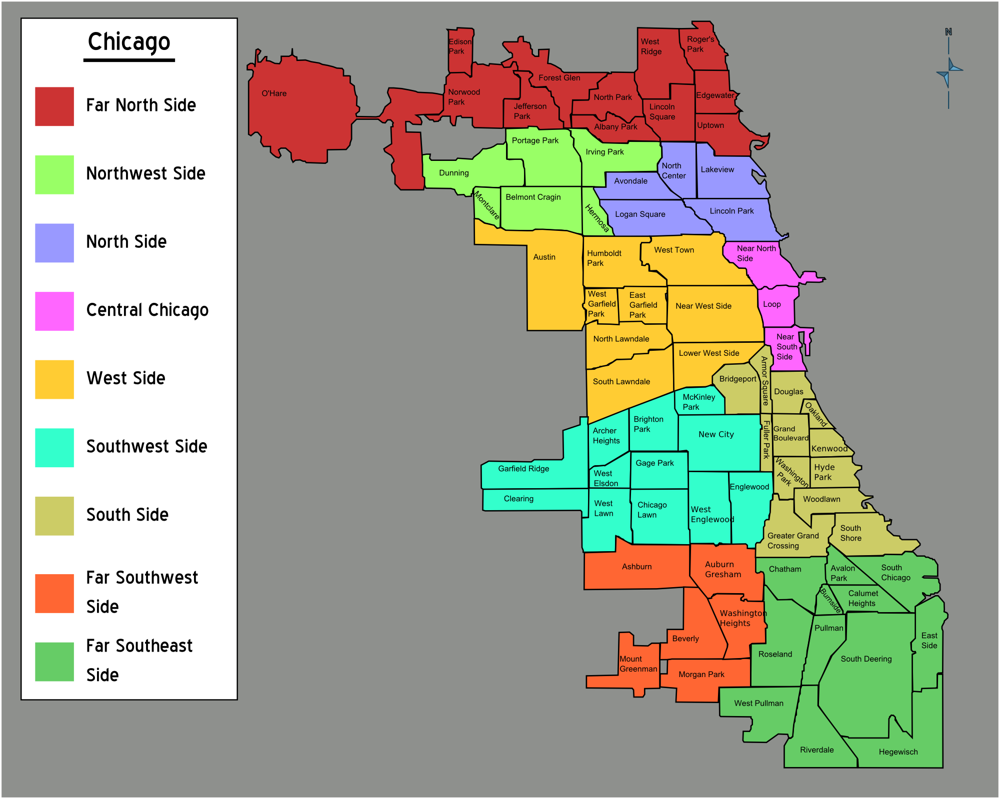

In [4]:
Image(
    "https://upload.wikimedia.org/wikipedia/commons/b/b3/Chicago_neighborhoods_map.png",
    width=700,
)

<https://en.wikivoyage.org/wiki/File:Chicago_neighborhoods_map.png>

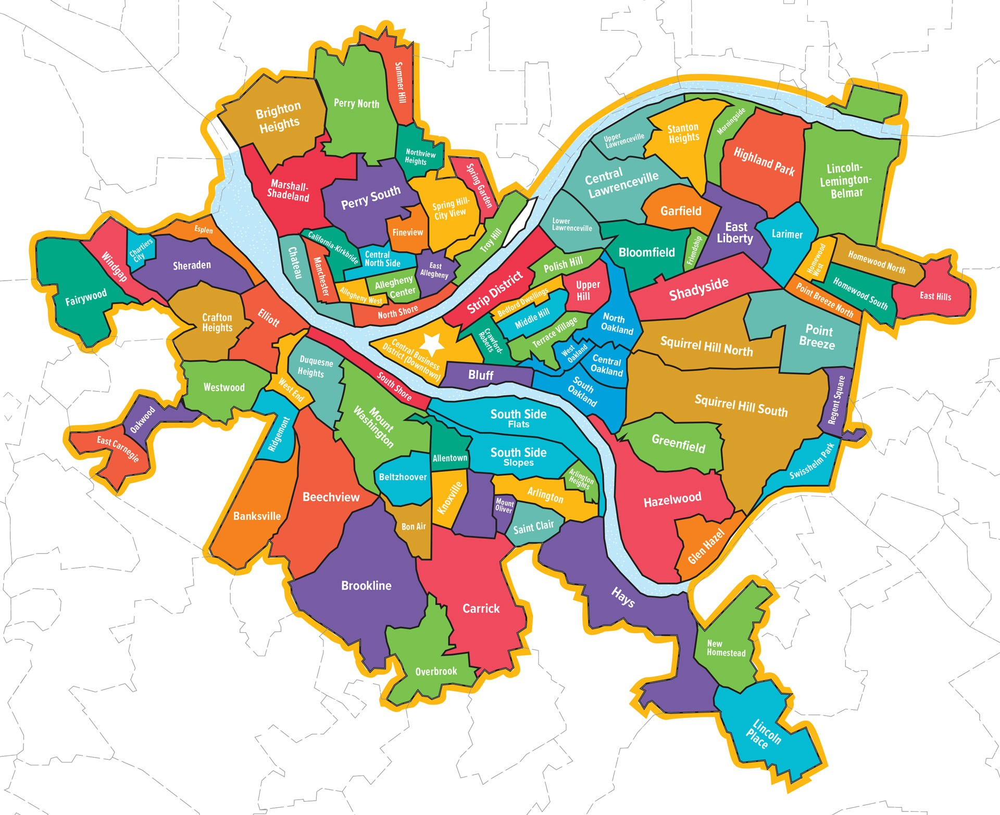

In [5]:
Image(
    "https://visit-pittsburgh-2023.s3.amazonaws.com/images/archive/2020-Neighborhood-Map2.jpg",
    width=700,
)

<https://www.visitpittsburgh.com/neighborhoods/>

In [6]:
datasets = DataStore()

In [7]:
la = gio.get_acs(datasets, county_fips="06037", years=2021, level="tract")

/Users/knaaptime/Dropbox/projects/geosnap/geosnap/io/util.py:275: UserWarning: Unable to find local adjustment year for 2021. Attempting from online data
  warn(
/Users/knaaptime/Dropbox/projects/geosnap/geosnap/io/constructors.py:215: UserWarning: Currency columns unavailable at this resolution; not adjusting for inflation
  warn(


In [8]:
la[["median_household_income", "geometry"]].explore(
    "median_household_income",
    scheme="quantiles",
    k=8,
    cmap="magma",
    tiles="CartoDB Positron",
)

In [9]:
columns = [
    "median_household_income",
    "median_home_value",
    "p_edu_college_greater",
    "p_edu_hs_less",
    "p_nonhisp_white_persons",
    "p_nonhisp_black_persons",
    "p_hispanic_persons",
    "p_asian_persons",
]

<Axes: >

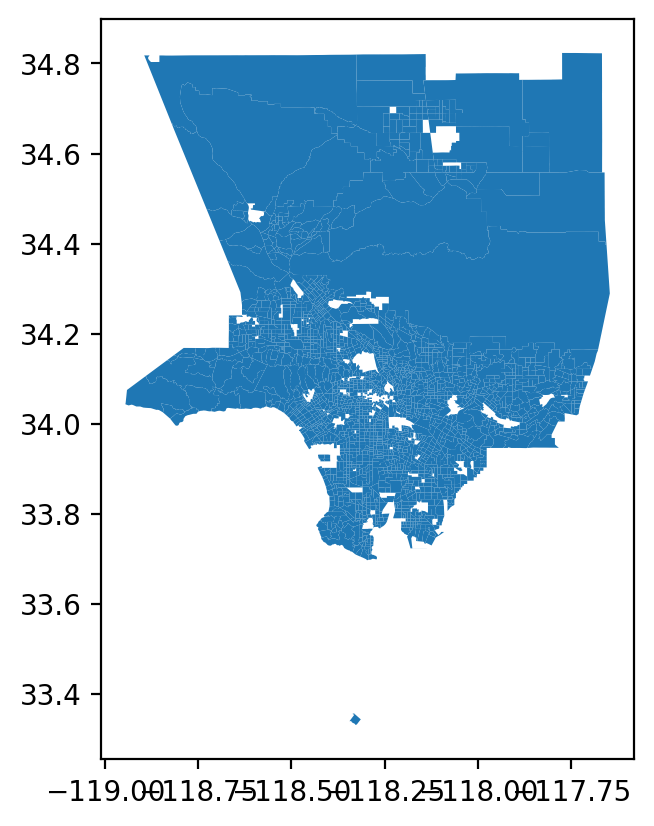

In [10]:
la.dropna(subset=columns).plot()

## Cross-Sectional Regionalization

In [11]:
la = la.to_crs(la.estimate_utm_crs())

In [12]:
la_ward_reg, la_ward_model = gaz.regionalize(
    gdf=la,
    method="ward_spatial",
    n_clusters=25,
    columns=columns,
    return_model=True,
    spatial_weights="queen",
)

/Users/knaaptime/Dropbox/projects/geosnap/geosnap/analyze/geodemo.py:406: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  w0 = W.from_dataframe(df, **weights_kwargs)
/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 4 disconnected components.
 There are 2 islands with ids: 568, 1944.
  warnings.warn(message)


In [13]:
la_ward_reg[columns + ["geometry", "ward_spatial"]].explore(
    "ward_spatial", categorical=True, cmap="Accent", tiles="CartoDB Positron"
)

Unlike the general clustering case, regionalization algorithms can only group together observations that are connected via a spatial connectivity graph. That means the map is much more distinctive, but the resulting clusters are usually far less homogenous internally than the unconstrained case.

To understand what the clusters are identifying, another data visualisation technique is useful. Here, we rely on the Tufte-ian principle of "small multiples", and create a set of violin plots that show how each variable is distributed across each of the clusters. Each of the inset boxes shows a different variable, with cluster assignments on the x-axis, and the variable itself on the y-axis The boxplot in the center shows the median and IQR, and the "body" of the "violin" is a kernel-density estimate reflected across the x-axis. In short, the fat parts of the violin show where the bulk of the observations are located, and the skinny "necks" show the long tails.

array([<Axes: title={'center': 'median_household_income'}, xlabel='ward_spatial', ylabel='median_household_income'>,
       <Axes: title={'center': 'median_home_value'}, xlabel='ward_spatial', ylabel='median_home_value'>,
       <Axes: title={'center': 'p_edu_college_greater'}, xlabel='ward_spatial', ylabel='p_edu_college_greater'>,
       <Axes: title={'center': 'p_edu_hs_less'}, xlabel='ward_spatial', ylabel='p_edu_hs_less'>,
       <Axes: title={'center': 'p_nonhisp_white_persons'}, xlabel='ward_spatial', ylabel='p_nonhisp_white_persons'>,
       <Axes: title={'center': 'p_nonhisp_black_persons'}, xlabel='ward_spatial', ylabel='p_nonhisp_black_persons'>,
       <Axes: title={'center': 'p_hispanic_persons'}, xlabel='ward_spatial', ylabel='p_hispanic_persons'>,
       <Axes: title={'center': 'p_asian_persons'}, xlabel='ward_spatial', ylabel='p_asian_persons'>,
       <Axes: >], dtype=object)

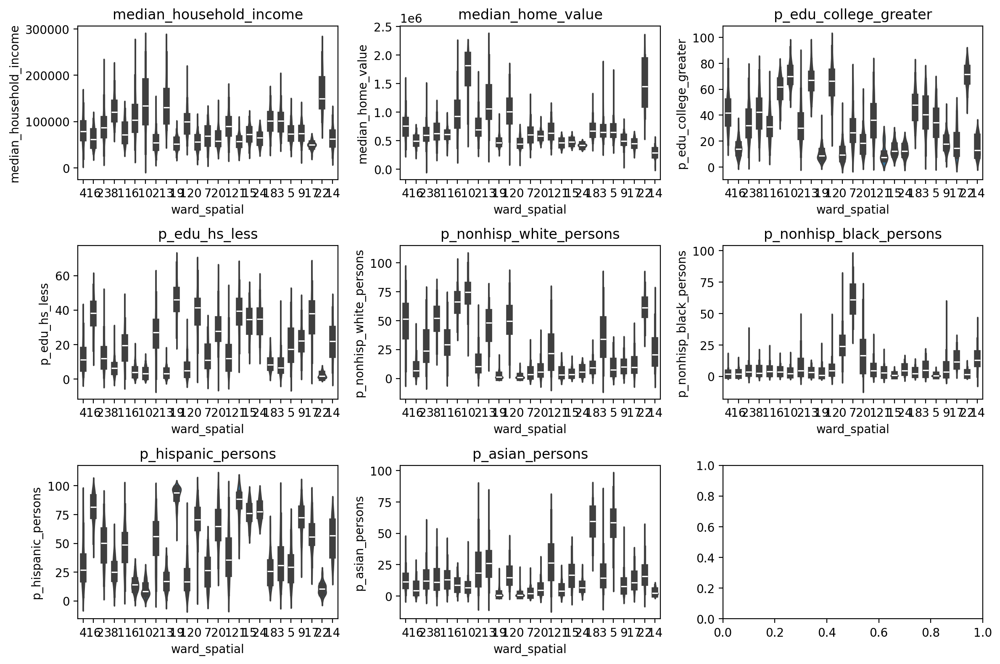

In [14]:
gvz.plot_violins_by_cluster(la_ward_reg, columns, cluster_col="ward_spatial")

Notice here that the violin plots are much harder to distinguish. That is, by enforcing a contiguity constraint, many census tracts are grouped with other tracts that they are closest to, rather than those they are most similar to in multivariate attribute space. This is reflected in the silhouette scores as well.

Unlike the general clustering case, regionalization algorithms return a dictionary of ModelResults classes (one for each unique time period in the dataset) because it is not possible to create a pooled regionalization solution using data from multiple time periods

In [15]:
la_ward_model

{2021: <geosnap.analyze._model_results.ModelResults at 0x2a50de0d0>}

<Axes: title={'center': 'Silhouette Score'}, xlabel='Silhouette coefficient values', ylabel='Cluster label'>

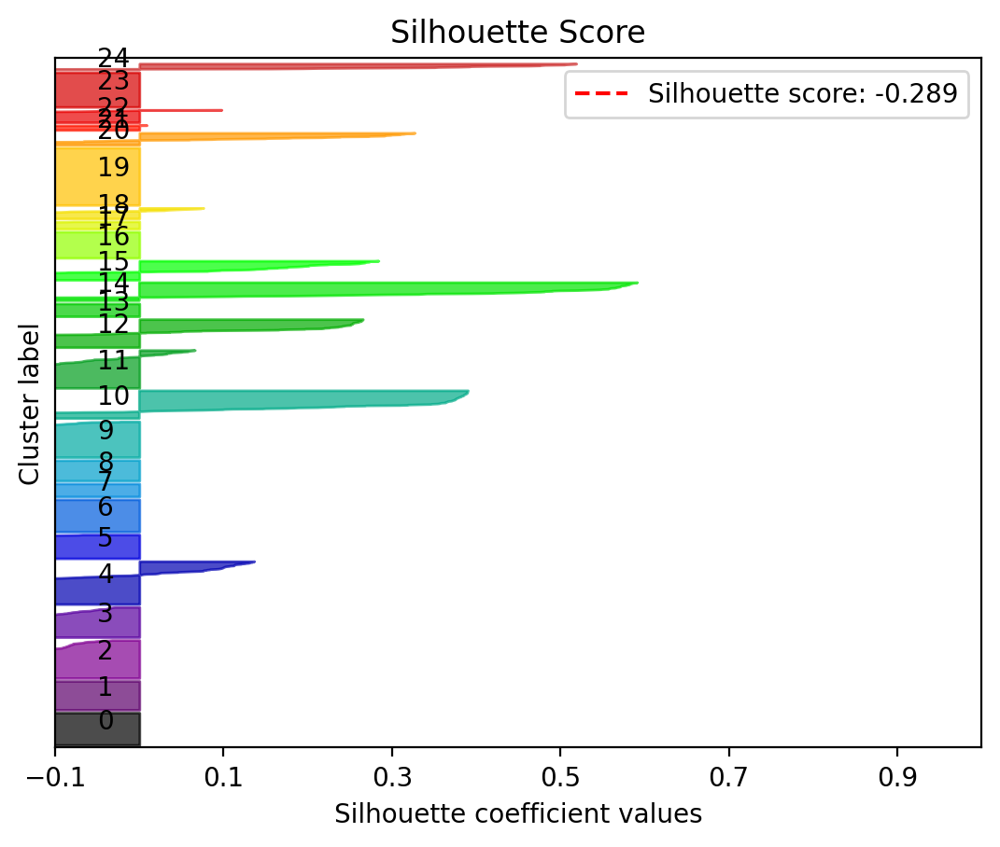

In [16]:
la_ward_model[2021].plot_silhouette()

This is a poor silhouette score indeed--the overall score for the solution is negative, meaning most tracts are more similar (in attributes) to tracts in another cluster than the one they are assigned. But a silhouette score is not the ideal metric in this case, because attribute similarity is no longer the only objective the model is trying to achieve.

/Users/knaaptime/Dropbox/projects/geosnap/geosnap/visualize/mapping.py:170: UserWarning: `proplot` is not installed.  Falling back to matplotlib
  warn("`proplot` is not installed.  Falling back to matplotlib")


[<Axes: title={'center': '2021'}>]

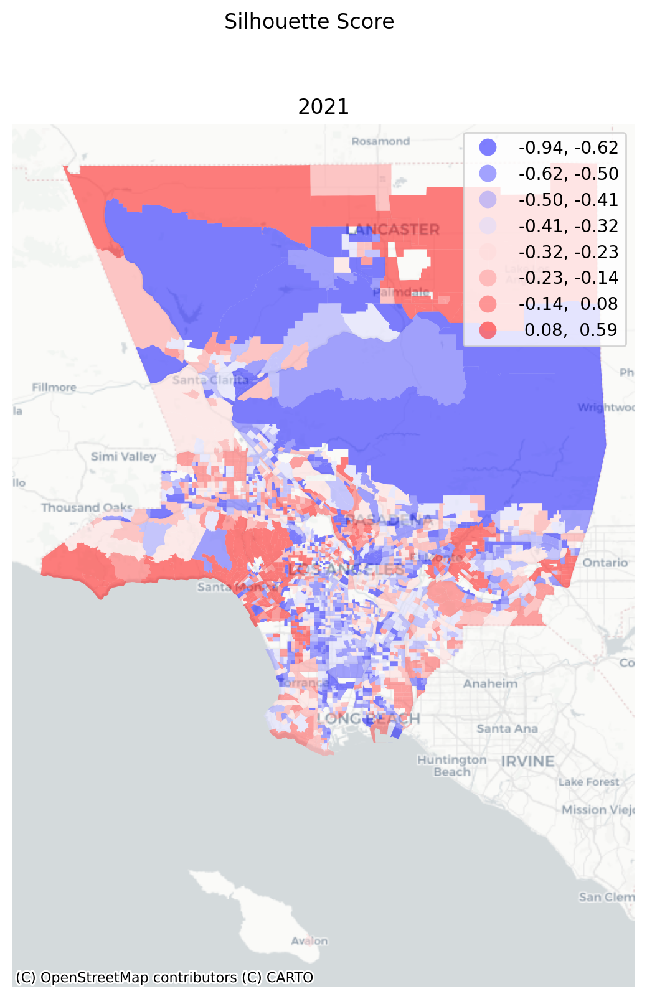

In [17]:
la_ward_model[2021].plot_silhouette_map(figsize=(9, 9))

Rather than searching for unique types, regardless of where they are in the study area (which is what general clustering algorithms focus on), regionalization algorithms arguable search for unique places in the study area, where uniqueness is defined by the concentration of attribute similarity in space. That is, we are looking for places that are *geographically distinct from their neighbors*, where members of a single region are relatively similar to one another, but distinctly different from those nearby.

To operationalize these concepts, we leverage the notion of a [geosilhouette](https://pysal.org/esda/notebooks/geosilhouettes.html), which blends the roles of geographic and attribute similarity into a single metric. There are two types of geosilhouettes, depending on whether we are most interested in differences between region cores (path silhouettes) or region boundaries (boundary silhouettes)

In [18]:
la_ward_model[2021].boundary_silhouette.boundary_silhouette.mean()

0.09576599634910776

/Users/knaaptime/Dropbox/projects/geosnap/geosnap/visualize/mapping.py:170: UserWarning: `proplot` is not installed.  Falling back to matplotlib
  warn("`proplot` is not installed.  Falling back to matplotlib")
/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/mapclassify/classifiers.py:1592: UserWarning: Not enough unique values in array to form 6 classes. Setting k to 4.
  self.bins = quantile(y, k=k)


[<Axes: title={'center': '2021'}>]

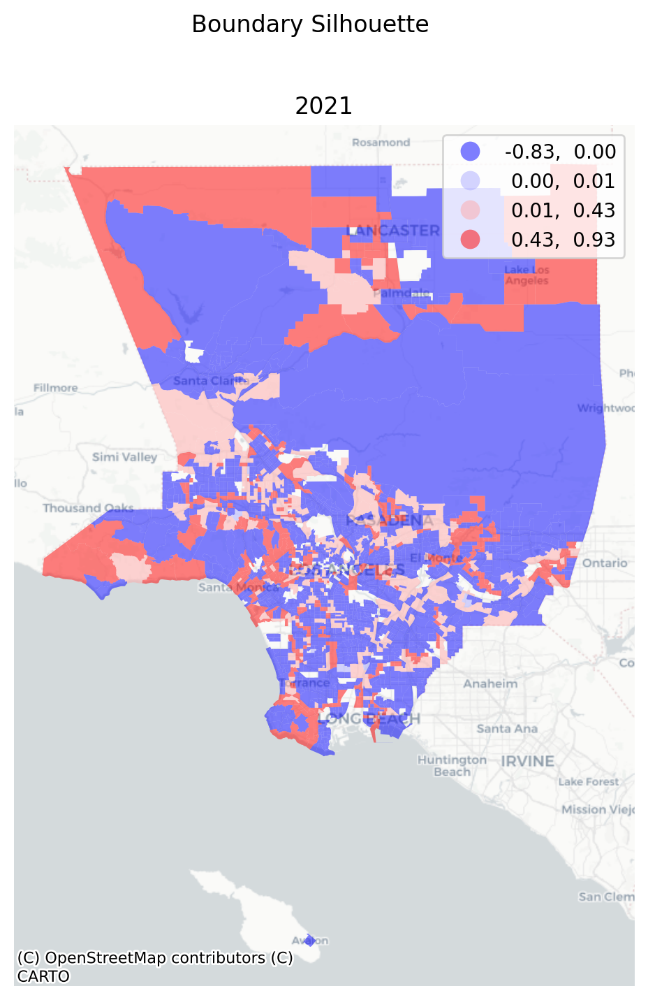

In [19]:
la_ward_model[2021].plot_boundary_silhouette(figsize=(8, 8))

In [20]:
la_ward_model[2021].path_silhouette.path_silhouette.mean()

0.04836626548915017

/Users/knaaptime/Dropbox/projects/geosnap/geosnap/visualize/mapping.py:170: UserWarning: `proplot` is not installed.  Falling back to matplotlib
  warn("`proplot` is not installed.  Falling back to matplotlib")


[<Axes: title={'center': '2021'}>]

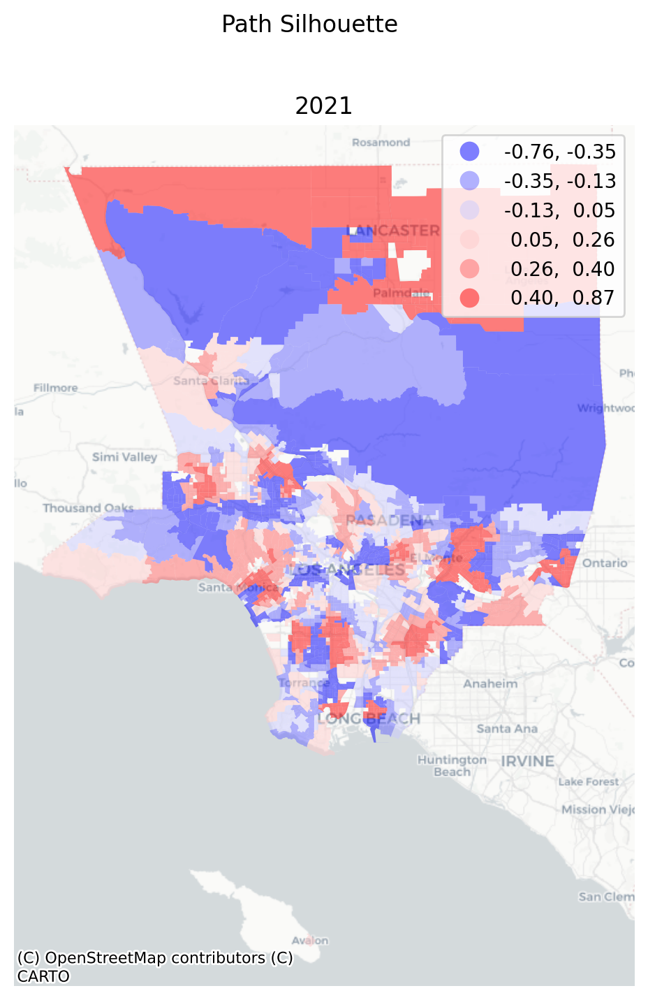

In [21]:
la_ward_model[2021].plot_path_silhouette(figsize=(8, 8))

There are also many regionalization algorithms to choose from (see the [PySAL `spopt`](https://pysal.org/spopt/) package for more information on each of them)

In [22]:
cluster_types = [
    "kmeans_spatial",
    "ward_spatial",
    "skater",
    "spenc",
    "azp",
]

In [23]:
from sklearn.preprocessing import MinMaxScaler

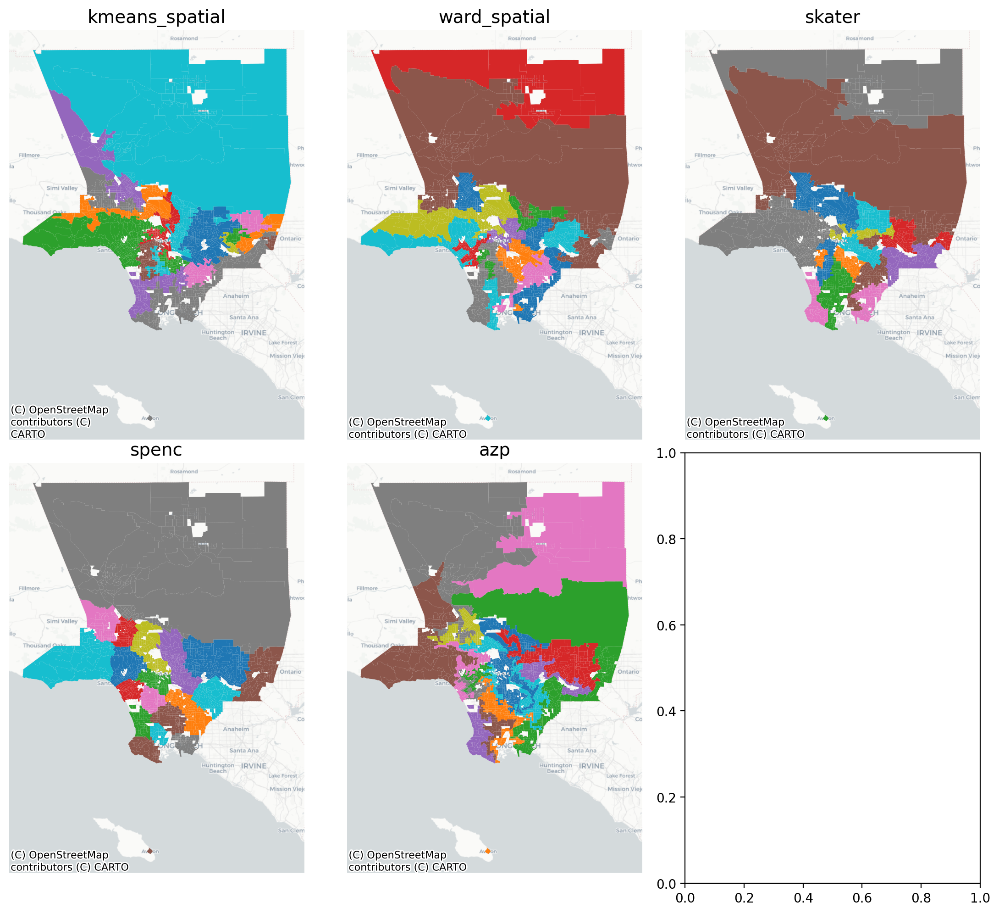

In [24]:
f, ax = plt.subplots(2, 3, figsize=(11, 10))
ax = ax.flatten()

for i, k in enumerate(cluster_types):
    df = gaz.regionalize(
        gdf=la,
        method=k,
        columns=columns,
        n_clusters=25,
        scaler=MinMaxScaler(),
        weights_kwargs=dict(use_index=True, silence_warnings=True),
        region_kwargs=dict(gamma=1),
    )
    df.to_crs(3857).sort_values(k).plot(k, categorical=True, figsize=(7, 7), ax=ax[i])
    ax[i].axis("off")
    ax[i].set_title(k, fontsize=14)
    ctx.add_basemap(ax=ax[i], source=ctx.providers.CartoDB.Positron)
    plt.tight_layout()

Again, the colors are arbitrary and the patterns (i.e. which tracts get grouped togethed in a single color) are the important parts

In [25]:
ks_best, ks_table = gaz.find_region_k(
    gdf=la,
    method="ward_spatial",
    columns=columns,
    min_k=2,
    max_k=50,
    return_table=True,
    weights_kwargs=dict(use_index=True, silence_warnings=True),
)

  0%|          | 0/49 [00:00<?, ?it/s]

In [26]:
ks_best

,silhouette_score,calinski_harabasz_score,path_silhouette,boundary_silhouette,davies_bouldin_score
time_period,,,,,
2021.0,2.0,2.0,2.0,50.0,2.0


In [27]:
ks_table

,silhouette_score,calinski_harabasz_score,davies_bouldin_score,path_silhouette,boundary_silhouette,time_period
k,,,,,,
2.0,0.398151,984.873146,1.142351,0.285660,0.156863,2021.0
3.0,-0.099869,540.893605,1.262321,-0.096397,0.134452,2021.0
4.0,-0.100067,561.134923,2.388560,-0.067966,0.156785,2021.0
5.0,-0.164610,420.742953,15.480583,-0.004911,0.147162,2021.0
6.0,-0.155095,475.288513,12.884447,-0.014573,0.170921,2021.0
7.0,-0.208675,396.009640,15.430332,-0.011200,0.160621,2021.0
8.0,-0.213824,364.579200,5.441137,0.011880,0.164475,2021.0
9.0,-0.232700,322.961558,5.853003,-0.066787,0.161105,2021.0
10.0,-0.232987,287.470732,6.417645,-0.086747,0.154685,2021.0


In [28]:
ks_table.columns

Index(['silhouette_score', 'calinski_harabasz_score', 'davies_bouldin_score',
       'path_silhouette', 'boundary_silhouette', 'time_period'],
      dtype='object')

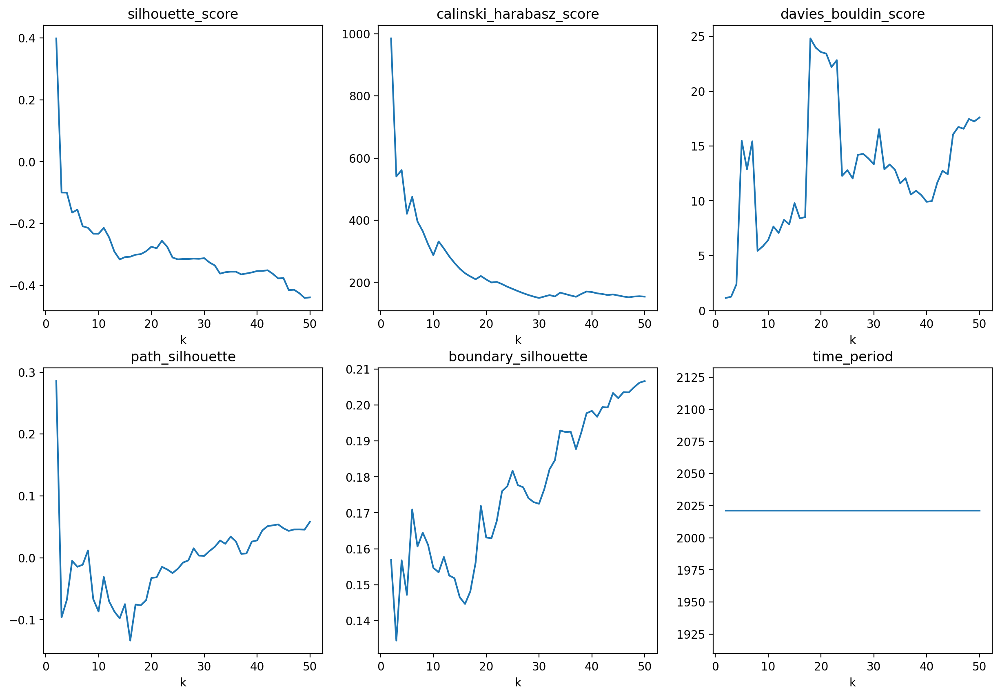

In [29]:
f, ax = plt.subplots(2, 3, figsize=(15, 10))
ax = ax.flatten()

for i, metric in enumerate(ks_table.columns.values):
    ks_table[metric].plot(ax=ax[i])
    ax[i].set_title(metric)

Whereas the general silhouette score (and the other general cluster metrics) decrease steadily is the number of clusters increases (because we start to split hairs into super specialized types), the geosilhouettes, especially the boundary silhouette generally increase as n_clusters increases because it becomes easier and easier to differentiate units from neighborhoods as you consider smaller and smaller neighborhoods.

In addition to the set of compositional attributes, a crucial input to regionalization algorithms is the spatial weights parameter (`W`), which defines the "geographic similarity" between units. Generally, the goal of regionalization algorithms is to define a distinct, contiguous [set of] region(s), which usually means using a contiguity-based `W` object (and as such, the default `W` is a Rook weight). But it is also possible to relax the contiguity enforcement using something like a distance-band weight, which would group nearby observations even if they are not necessarily touching each other. 

In [30]:
from libpysal.weights import DistanceBand

la_distance_band = gaz.regionalize(
    gdf=la,
    columns=columns,
    method="ward_spatial",
    n_clusters=25,
    spatial_weights=DistanceBand,
    weights_kwargs=dict(threshold=2000),
)

/Users/knaaptime/mambaforge/envs/geosnap/lib/python3.11/site-packages/libpysal/weights/weights.py:224: UserWarning: The weights matrix is not fully connected: 
 There are 107 disconnected components.
 There are 91 islands with ids: 10, 14, 15, 52, 828, 831, 833, 1012, 1078, 1085, 1086, 1087, 1089, 1146, 1255, 1277, 1283, 1467, 1468, 1471, 1489, 1706, 1944, 2112, 2115, 2117, 2166, 2167, 2168, 2169, 2171, 2174, 2175, 2178, 2179, 2180, 2182, 2183, 2184, 2185, 2186, 2187, 2188, 2189, 2190, 2191, 2193, 2214, 2215, 2221, 2226, 2227, 2228, 2230, 2231, 2232, 2233, 2234, 2236, 2237, 2238, 2242, 2243, 2246, 2260, 2270, 2272, 2273, 2274, 2275, 2276, 2277, 2278, 2284, 2296, 2302, 2303, 2304, 2305, 2306, 2314, 2316, 2317, 2318, 2319, 2321, 2323, 2330, 2331, 2336, 2337.
  warnings.warn(message)


In [31]:
la_distance_band[["ward_spatial", "geometry"]].explore(
    "ward_spatial", categorical=True, tiles="CartoDB Positron"
)

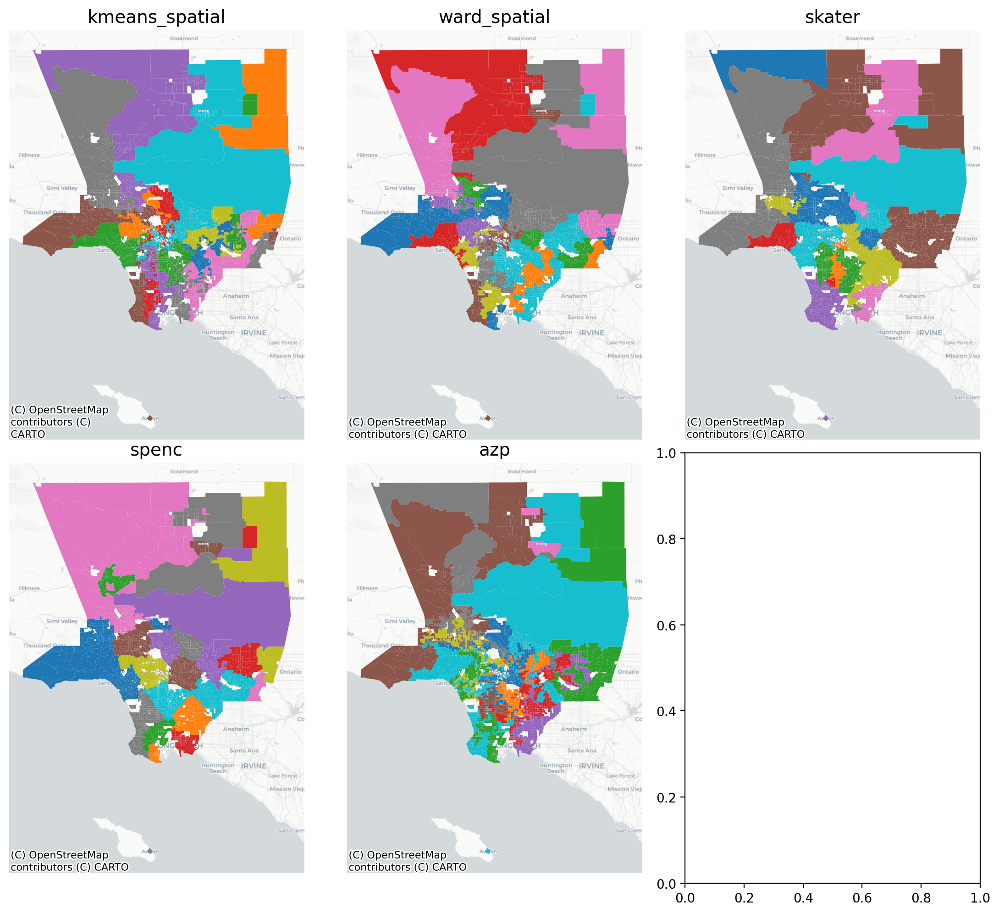

In [32]:
f, ax = plt.subplots(2, 3, figsize=(11, 10))
ax = ax.flatten()
la = la.to_crs(la.estimate_utm_crs())
for i, k in enumerate(cluster_types):
    df = gaz.regionalize(
        gdf=la,
        method=k,
        columns=columns,
        spatial_weights=DistanceBand,
        n_clusters=25,
        scaler=MinMaxScaler(),
        weights_kwargs=dict(use_index=True, threshold=2000, silence_warnings=True),
        region_kwargs=dict(gamma=0.25),
    )
    df.to_crs(3857).sort_values(k).plot(k, categorical=True, figsize=(7, 7), ax=ax[i])
    ax[i].axis("off")
    ax[i].set_title(k, fontsize=14)
    ctx.add_basemap(ax=ax[i], source=ctx.providers.CartoDB.Positron)
    plt.tight_layout()